In [1]:
#Balanced Encoder Decoder 
#BottleNeck: 16

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[10, 8], [12, 10], [14, 12], [16, 14], [18, 16], [20, 18] ,[22,20]]
decoder_dense_layers_trial = [[8, 10], [10, 12], [12, 14], [14, 16], [16, 18], [18, 20], [20,22]]
bottle_neck_trial = [16]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[10, 8] 16 [8, 10]
[10, 8] 16 [10, 12]
[10, 8] 16 [12, 14]
[10, 8] 16 [14, 16]
[10, 8] 16 [16, 18]
[10, 8] 16 [18, 20]
[10, 8] 16 [20, 22]
[12, 10] 16 [8, 10]
[12, 10] 16 [10, 12]
[12, 10] 16 [12, 14]
[12, 10] 16 [14, 16]
[12, 10] 16 [16, 18]
[12, 10] 16 [18, 20]
[12, 10] 16 [20, 22]
[14, 12] 16 [8, 10]
[14, 12] 16 [10, 12]
[14, 12] 16 [12, 14]
[14, 12] 16 [14, 16]
[14, 12] 16 [16, 18]
[14, 12] 16 [18, 20]
[14, 12] 16 [20, 22]
[16, 14] 16 [8, 10]
[16, 14] 16 [10, 12]
[16, 14] 16 [12, 14]
[16, 14] 16 [14, 16]
[16, 14] 16 [16, 18]
[16, 14] 16 [18, 20]
[16, 14] 16 [20, 22]
[18, 16] 16 [8, 10]
[18, 16] 16 [10, 12]
[18, 16] 16 [12, 14]
[18, 16] 16 [14, 16]
[18, 16] 16 [16, 18]
[18, 16] 16 [18, 20]
[18, 16] 16 [20, 22]
[20, 18] 16 [8, 10]
[20, 18] 16 [10, 12]
[20, 18] 16 [12, 14]
[20, 18] 16 [14, 16]
[20, 18] 16 [16, 18]
[20, 18] 16 [18, 20]
[20, 18] 16 [20, 22]
[22, 20] 16 [8, 10]
[22, 20] 16 [10, 12]
[22, 20] 16 [12, 14]
[22, 20] 16 [14, 16]
[22, 20] 16 [16, 18]

[10, 8] 16 [8, 10]
[10, 8] 16 [8, 10]

L24_E10_8_B16_D8_10

Training model: L24_E10_8_B16_D8_10
Training Complete:
Last epoch loss: 0.014438889920711517
Last epoch validation loss: 0.022198021411895752
Reports Saved
[10, 8] 16 [10, 12]
[10, 8] 16 [10, 12]

L24_E10_8_B16_D10_12

Training model: L24_E10_8_B16_D10_12
Training Complete:
Last epoch loss: 0.012854735367000103
Last epoch validation loss: 0.021357154473662376
Reports Saved
[10, 8] 16 [12, 14]
[10, 8] 16 [12, 14]

L24_E10_8_B16_D12_14

Training model: L24_E10_8_B16_D12_14
Training Complete:
Last epoch loss: 0.010929574258625507
Last epoch validation loss: 0.018578914925456047
Reports Saved
[10, 8] 16 [14, 16]
[10, 8] 16 [14, 16]

L24_E10_8_B16_D14_16

Training model: L24_E10_8_B16_D14_16
Training Complete:
Last epoch loss: 0.012646293267607689
Last epoch validation loss: 0.018443601205945015
Reports Saved
[10, 8] 16 [16, 18]
[10, 8] 16 [16, 18]

L24_E10_8_B16_D16_18

Training model: L24_E10_8_B16_D16_18
Training Complete:
Last 

Reports Saved
[12, 10] 16 [18, 20]
[12, 10] 16 [18, 20]

L24_E12_10_B16_D18_20

Training model: L24_E12_10_B16_D18_20
Training Complete:
Last epoch loss: 0.011896967887878418
Last epoch validation loss: 0.01902337744832039
Reports Saved
[12, 10] 16 [20, 22]
[12, 10] 16 [20, 22]

L24_E12_10_B16_D20_22

Training model: L24_E12_10_B16_D20_22
Training Complete:
Last epoch loss: 0.007902915589511395
Last epoch validation loss: 0.013832668773829937
Reports Saved
[14, 12] 16 [8, 10]
[14, 12] 16 [8, 10]

L24_E14_12_B16_D8_10

Training model: L24_E14_12_B16_D8_10
Training Complete:
Last epoch loss: 0.012019926682114601
Last epoch validation loss: 0.017690079286694527
Reports Saved
[14, 12] 16 [10, 12]
[14, 12] 16 [10, 12]

L24_E14_12_B16_D10_12

Training model: L24_E14_12_B16_D10_12
Training Complete:
Last epoch loss: 0.013313841074705124
Last epoch validation loss: 0.01937347836792469
Reports Saved
[14, 12] 16 [12, 14]
[14, 12] 16 [12, 14]

L24_E14_12_B16_D12_14

Training model: L24_E14_12_B16

Reports Saved
[16, 14] 16 [8, 10]
[16, 14] 16 [8, 10]

L24_E16_14_B16_D8_10

Training model: L24_E16_14_B16_D8_10
Training Complete:
Last epoch loss: 0.0134035125374794
Last epoch validation loss: 0.020597679540514946
Reports Saved
[16, 14] 16 [10, 12]
[16, 14] 16 [10, 12]

L24_E16_14_B16_D10_12

Training model: L24_E16_14_B16_D10_12
Training Complete:
Last epoch loss: 0.007176967803388834
Last epoch validation loss: 0.012844113633036613
Reports Saved
[16, 14] 16 [12, 14]
[16, 14] 16 [12, 14]

L24_E16_14_B16_D12_14

Training model: L24_E16_14_B16_D12_14
Training Complete:
Last epoch loss: 0.016571030020713806
Last epoch validation loss: 0.024360161274671555
Reports Saved
[16, 14] 16 [14, 16]
[16, 14] 16 [14, 16]

L24_E16_14_B16_D14_16

Training model: L24_E16_14_B16_D14_16
Training Complete:
Last epoch loss: 0.009002742357552052
Last epoch validation loss: 0.015618296340107918
Reports Saved
[16, 14] 16 [16, 18]
[16, 14] 16 [16, 18]

L24_E16_14_B16_D16_18

Training model: L24_E16_14_B16

Reports Saved
[18, 16] 16 [12, 14]
[18, 16] 16 [12, 14]

L24_E18_16_B16_D12_14

Training model: L24_E18_16_B16_D12_14
Training Complete:
Last epoch loss: 0.009258920326828957
Last epoch validation loss: 0.014856026507914066
Reports Saved
[18, 16] 16 [14, 16]
[18, 16] 16 [14, 16]

L24_E18_16_B16_D14_16

Training model: L24_E18_16_B16_D14_16
Training Complete:
Last epoch loss: 0.0065691061317920685
Last epoch validation loss: 0.01191184762865305
Reports Saved
[18, 16] 16 [16, 18]
[18, 16] 16 [16, 18]

L24_E18_16_B16_D16_18

Training model: L24_E18_16_B16_D16_18
Training Complete:
Last epoch loss: 0.007048017345368862
Last epoch validation loss: 0.015030492097139359
Reports Saved
[18, 16] 16 [18, 20]
[18, 16] 16 [18, 20]

L24_E18_16_B16_D18_20

Training model: L24_E18_16_B16_D18_20
Training Complete:
Last epoch loss: 0.008414930664002895
Last epoch validation loss: 0.012840475887060165
Reports Saved
[18, 16] 16 [20, 22]
[18, 16] 16 [20, 22]

L24_E18_16_B16_D20_22

Training model: L24_E18_

Reports Saved
[20, 18] 16 [16, 18]
[20, 18] 16 [16, 18]

L24_E20_18_B16_D16_18

Training model: L24_E20_18_B16_D16_18
Training Complete:
Last epoch loss: 0.010161802172660828
Last epoch validation loss: 0.015694066882133484
Reports Saved
[20, 18] 16 [18, 20]
[20, 18] 16 [18, 20]

L24_E20_18_B16_D18_20

Training model: L24_E20_18_B16_D18_20
Training Complete:
Last epoch loss: 0.009407548233866692
Last epoch validation loss: 0.015331411734223366
Reports Saved
[20, 18] 16 [20, 22]
[20, 18] 16 [20, 22]

L24_E20_18_B16_D20_22

Training model: L24_E20_18_B16_D20_22
Training Complete:
Last epoch loss: 0.007467068266123533
Last epoch validation loss: 0.013502461835741997
Reports Saved
[22, 20] 16 [8, 10]
[22, 20] 16 [8, 10]

L24_E22_20_B16_D8_10

Training model: L24_E22_20_B16_D8_10
Training Complete:
Last epoch loss: 0.012481581419706345
Last epoch validation loss: 0.018508102744817734
Reports Saved
[22, 20] 16 [10, 12]
[22, 20] 16 [10, 12]

L24_E22_20_B16_D10_12

Training model: L24_E22_20_B

Reports Saved
[22, 20] 16 [20, 22]
[22, 20] 16 [20, 22]

L24_E22_20_B16_D20_22

Training model: L24_E22_20_B16_D20_22
Training Complete:
Last epoch loss: 0.007021848578006029
Last epoch validation loss: 0.012291383929550648
Reports Saved
Total time: 48.33893096049626 minutes


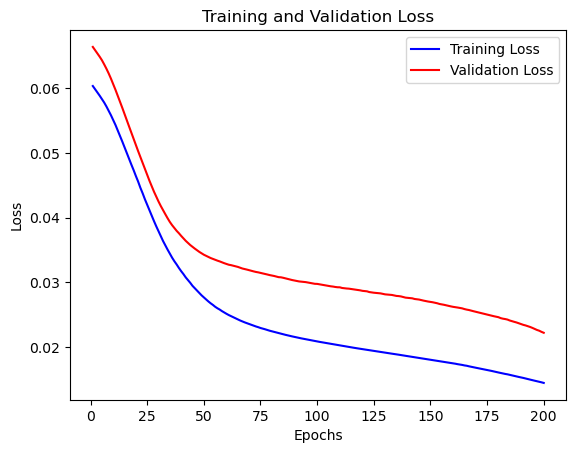

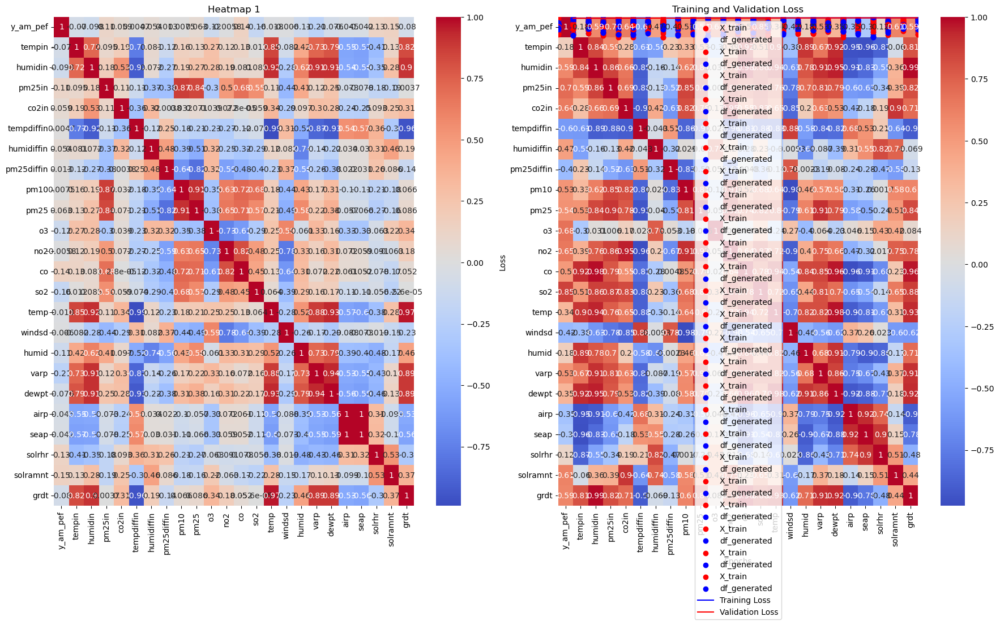

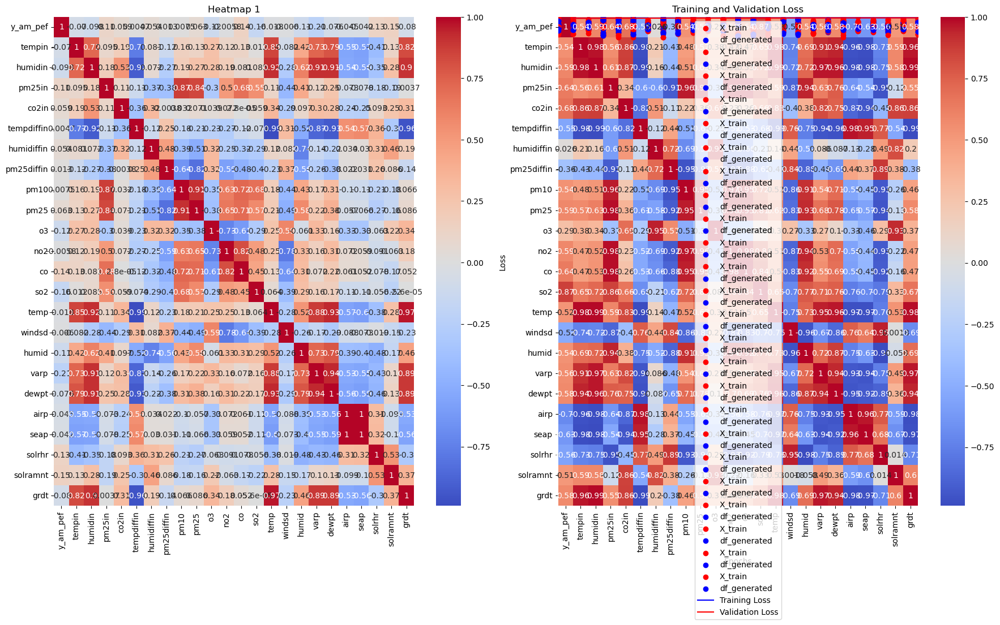

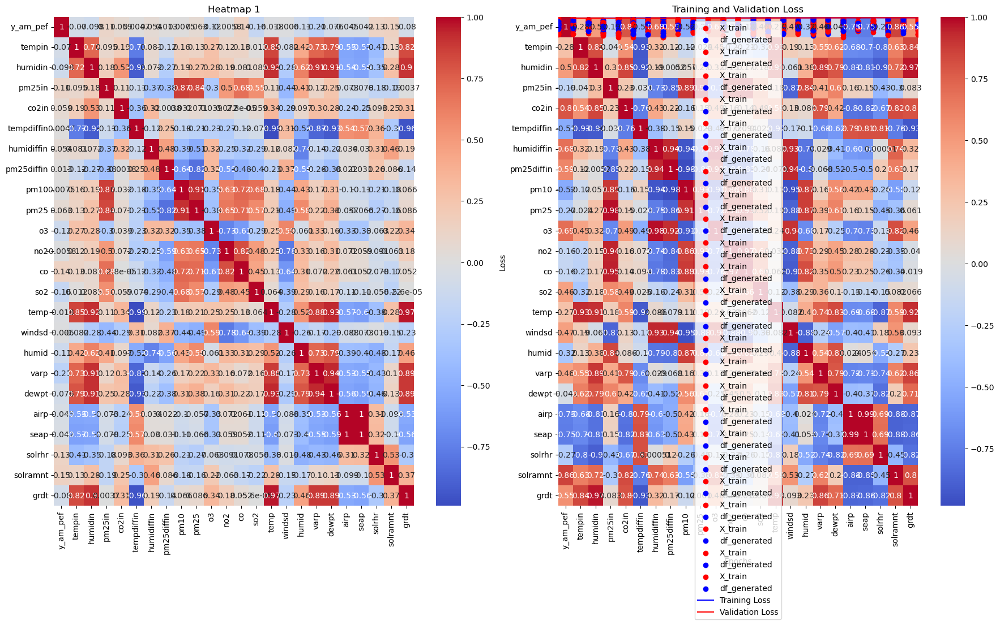

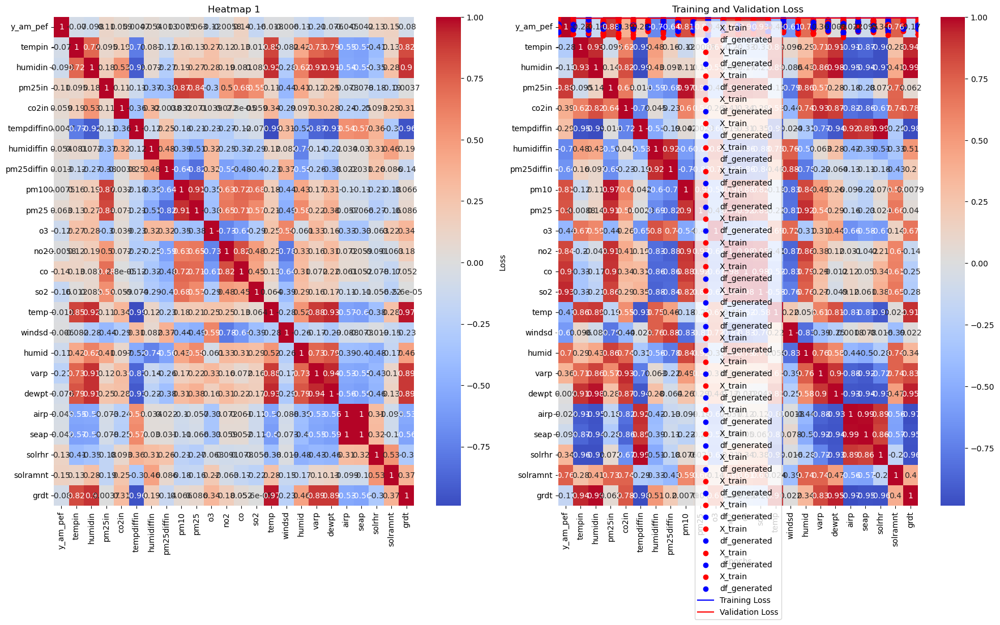

...

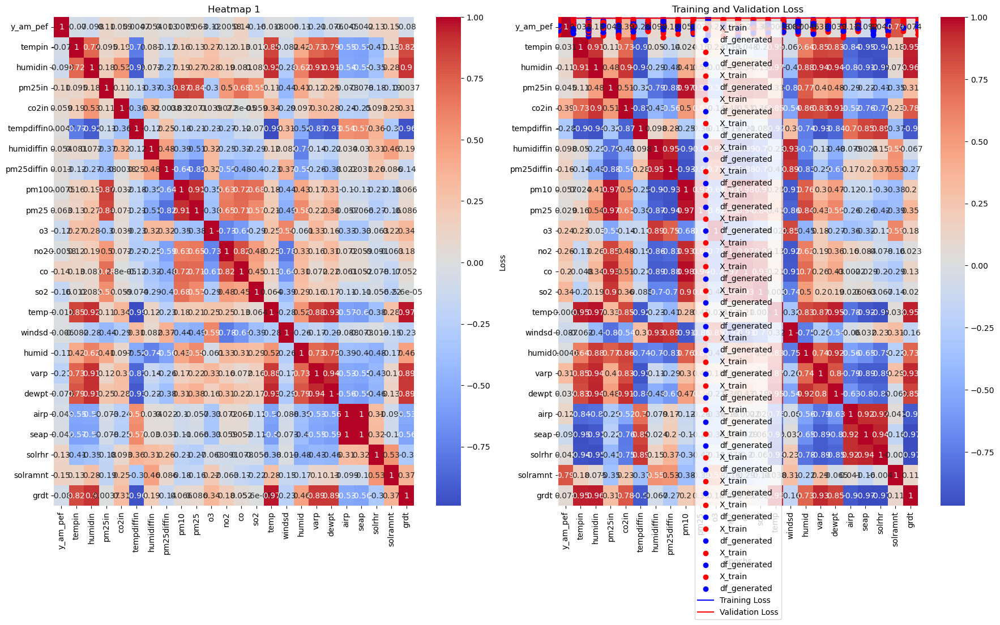

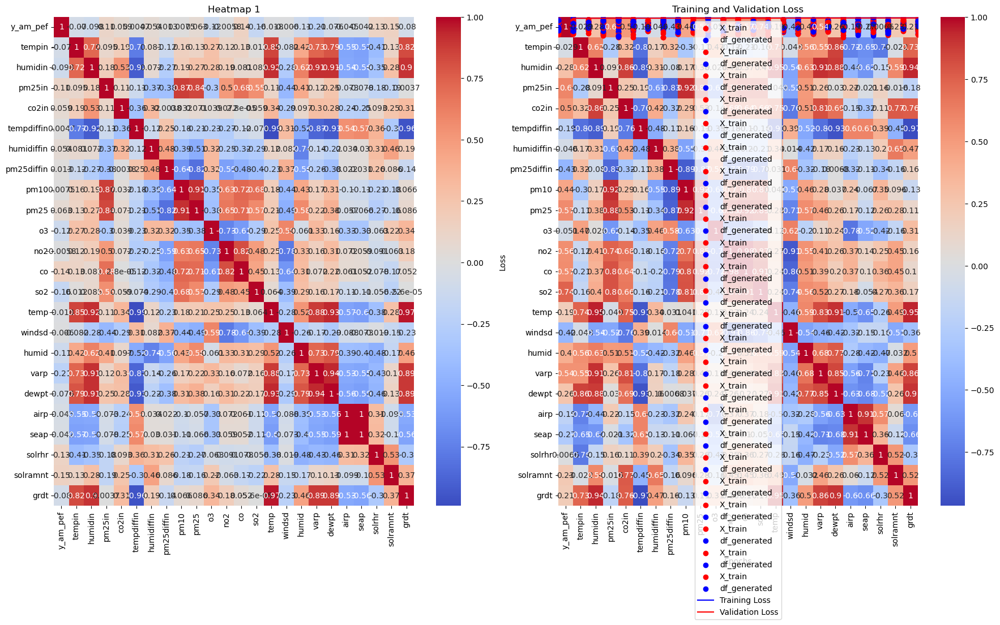

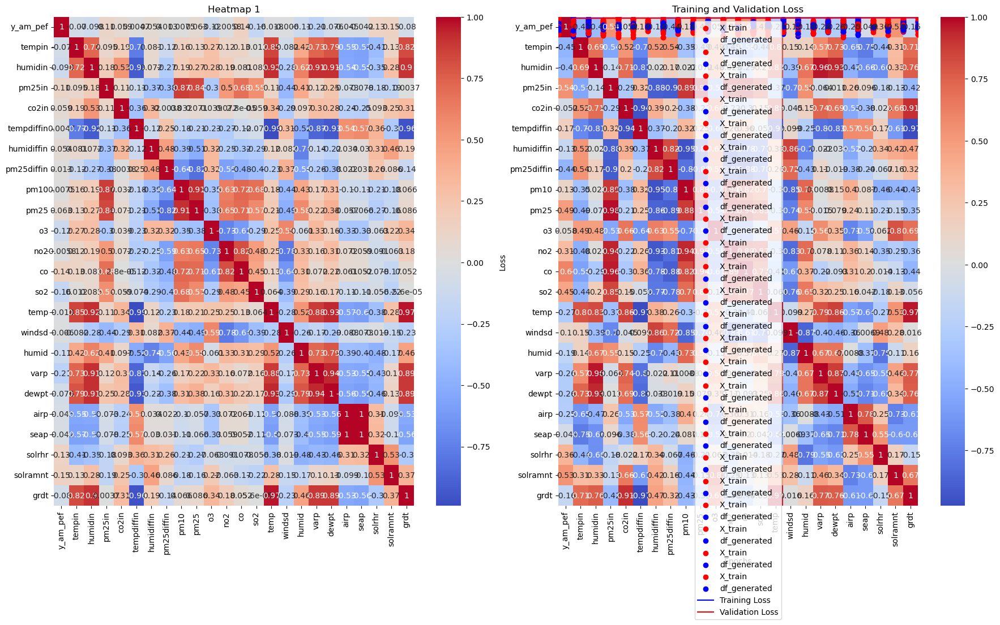

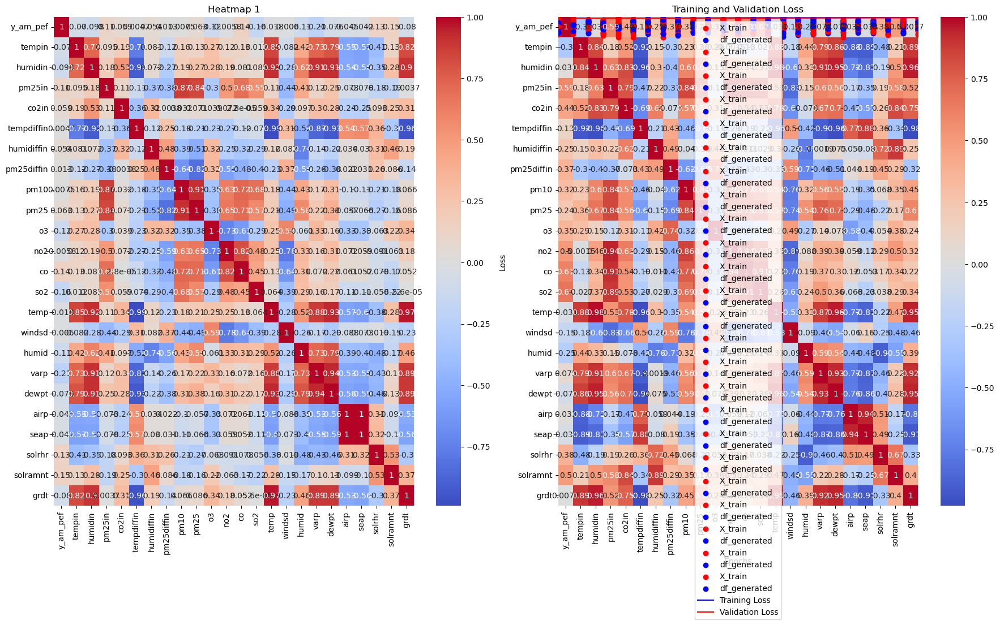

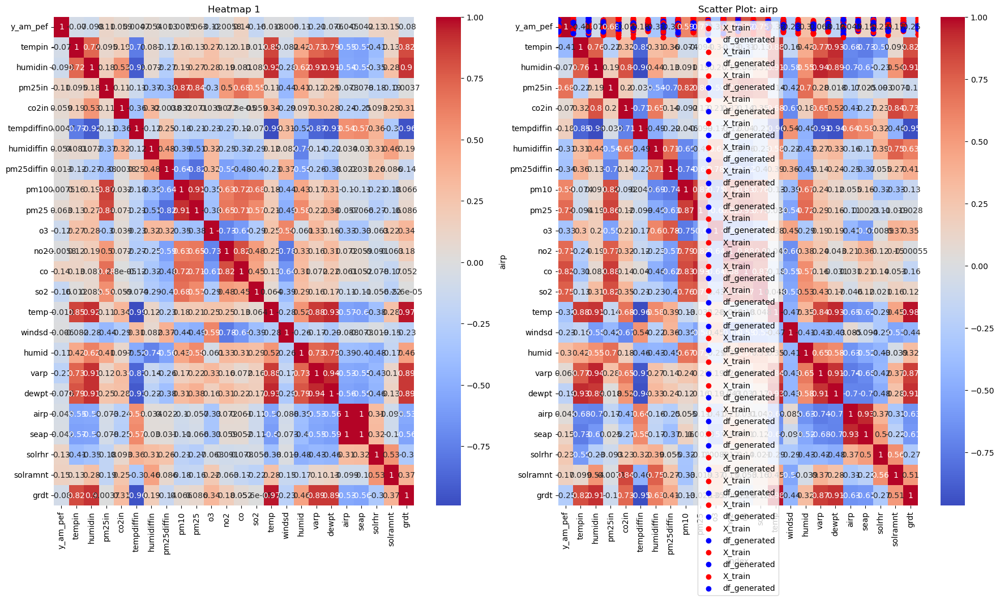

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
print(run_summary)

[['L24_E10_8_B16_D8_10', 0.014438889920711517, 0.022198021411895752], ['L24_E10_8_B16_D10_12', 0.012854735367000103, 0.021357154473662376], ['L24_E10_8_B16_D12_14', 0.010929574258625507, 0.018578914925456047], ['L24_E10_8_B16_D14_16', 0.012646293267607689, 0.018443601205945015], ['L24_E10_8_B16_D16_18', 0.01094544492661953, 0.016249189153313637], ['L24_E10_8_B16_D18_20', 0.012531960383057594, 0.019771603867411613], ['L24_E10_8_B16_D20_22', 0.010982584208250046, 0.0188333448022604], ['L24_E12_10_B16_D8_10', 0.01021888293325901, 0.017238793894648552], ['L24_E12_10_B16_D10_12', 0.011635716073215008, 0.01822877675294876], ['L24_E12_10_B16_D12_14', 0.011159241199493408, 0.018570641055703163], ['L24_E12_10_B16_D14_16', 0.011635184288024902, 0.01965210773050785], ['L24_E12_10_B16_D16_18', 0.0076018949039280415, 0.01369711197912693], ['L24_E12_10_B16_D18_20', 0.011896967887878418, 0.01902337744832039], ['L24_E12_10_B16_D20_22', 0.007902915589511395, 0.013832668773829937], ['L24_E14_12_B16_D8_1

In [14]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [15]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E16_14_B16_D12_14', 0.016571030020713806, 0.024360161274671555]
['L24_E14_12_B16_D12_14', 0.014628787524998188, 0.021947896108031273]
['L24_E10_8_B16_D8_10', 0.014438889920711517, 0.022198021411895752]
['L24_E16_14_B16_D8_10', 0.0134035125374794, 0.020597679540514946]
['L24_E14_12_B16_D10_12', 0.013313841074705124, 0.01937347836792469]
['L24_E10_8_B16_D10_12', 0.012854735367000103, 0.021357154473662376]
['L24_E10_8_B16_D14_16', 0.012646293267607689, 0.018443601205945015]
['L24_E10_8_B16_D18_20', 0.012531960383057594, 0.019771603867411613]
['L24_E22_20_B16_D8_10', 0.012481581419706345, 0.018508102744817734]
['L24_E22_20_B16_D12_14', 0.01215517520904541, 0.018602479249238968]


In [16]:
for item in run_summary:
    print(item)

['L24_E16_14_B16_D12_14', 0.016571030020713806, 0.024360161274671555]
['L24_E14_12_B16_D12_14', 0.014628787524998188, 0.021947896108031273]
['L24_E10_8_B16_D8_10', 0.014438889920711517, 0.022198021411895752]
['L24_E16_14_B16_D8_10', 0.0134035125374794, 0.020597679540514946]
['L24_E14_12_B16_D10_12', 0.013313841074705124, 0.01937347836792469]
['L24_E10_8_B16_D10_12', 0.012854735367000103, 0.021357154473662376]
['L24_E10_8_B16_D14_16', 0.012646293267607689, 0.018443601205945015]
['L24_E10_8_B16_D18_20', 0.012531960383057594, 0.019771603867411613]
['L24_E22_20_B16_D8_10', 0.012481581419706345, 0.018508102744817734]
['L24_E22_20_B16_D12_14', 0.01215517520904541, 0.018602479249238968]
['L24_E14_12_B16_D8_10', 0.012019926682114601, 0.017690079286694527]
['L24_E12_10_B16_D18_20', 0.011896967887878418, 0.01902337744832039]
['L24_E12_10_B16_D10_12', 0.011635716073215008, 0.01822877675294876]
['L24_E12_10_B16_D14_16', 0.011635184288024902, 0.01965210773050785]
['L24_E18_16_B16_D10_12', 0.0116152